In [1]:
import tensorflow as tf
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Activation, Dropout, BatchNormalization
from tensorflow.keras.optimizers import RMSprop, Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from PIL import Image
from skimage import transform

In [2]:
photo_size=224

In [3]:
def prepare_dataset(data_dir):
    datagen = ImageDataGenerator(
        rescale= 1/255,
        rotation_range=40,
        width_shift_range=.2,
        height_shift_range=.2,
        shear_range=.1,
        horizontal_flip=True,
        fill_mode='nearest',
        zoom_range=.2,
    )
    generator = datagen.flow_from_directory(
        data_dir,
        target_size=(photo_size,photo_size),
        class_mode='binary',
        batch_size=128,
        classes=['non_autistic','autistic']
    )
    return generator

In [4]:
train_data=prepare_dataset('../input/autistic-children-facial-data-set/train/')
validation_data = prepare_dataset('../input/autistic-children-facial-data-set/valid/')
test_data=prepare_dataset('../input/autistic-children-facial-data-set/test/')

Found 2536 images belonging to 2 classes.
Found 100 images belonging to 2 classes.
Found 300 images belonging to 2 classes.


In [5]:
validation_data.class_indices

{'non_autistic': 0, 'autistic': 1}

In [6]:
# example of tending the vgg16 model
def create_vgg_model():
    from keras.applications.vgg16 import VGG16
    from keras.models import Model
    from keras.layers import Dense
    from keras.layers import Flatten
    # load model without classifier layers
    model = VGG16(include_top=False, input_shape=(photo_size, photo_size, 3))
    for layer_idx in range(len(model.layers)):
        if layer_idx not in [1,2,3,15,16,17,18]:
            model.layers[layer_idx].trainable = False
    # add new classifier layers
    flat1 = Flatten()(model.layers[-1].output)
    class1 = Dense(256, activation='relu')(flat1)
    output = Dense(95, activation='softmax')(class1)
    # define new model
    model = Model(inputs=model.inputs, outputs=output)
    return model

In [7]:
vgg_model=create_vgg_model()
vgg_model.summary()

2022-11-27 07:23:31.451075: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-27 07:23:31.567483: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-27 07:23:31.568327: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-27 07:23:31.569884: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compil

58900480/58889256 [==============================] - 3s 0us/step
Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
______________________________________________________________

In [8]:
vgg_model.compile(optimizer=Adam(learning_rate=0.001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
vgghist=vgg_model.fit(
    train_data,
    epochs=100,
    validation_data=validation_data
)
vgg_model.save("vgg_model50.h5")

2022-11-27 07:23:39.886314: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/100


2022-11-27 07:23:43.558318: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


20/20 [==============================] - 80s 3s/step - loss: 1.7290 - accuracy: 0.4779 - val_loss: 0.6782 - val_accuracy: 0.5400
Epoch 2/100
20/20 [==============================] - 37s 2s/step - loss: 0.6865 - accuracy: 0.5524 - val_loss: 0.6665 - val_accuracy: 0.6100
Epoch 3/100
20/20 [==============================] - 37s 2s/step - loss: 0.6851 - accuracy: 0.5615 - val_loss: 0.6507 - val_accuracy: 0.5900
Epoch 4/100
20/20 [==============================] - 37s 2s/step - loss: 0.6503 - accuracy: 0.6100 - val_loss: 0.6279 - val_accuracy: 0.6600
Epoch 5/100
20/20 [==============================] - 37s 2s/step - loss: 0.6148 - accuracy: 0.6609 - val_loss: 0.6053 - val_accuracy: 0.6200
Epoch 6/100
20/20 [==============================] - 37s 2s/step - loss: 0.5872 - accuracy: 0.6960 - val_loss: 0.5675 - val_accuracy: 0.6800
Epoch 7/100
20/20 [==============================] - 37s 2s/step - loss: 0.5527 - accuracy: 0.7236 - val_loss: 0.5801 - val_accuracy: 0.7300
Epoch 8/100
20/20 [======

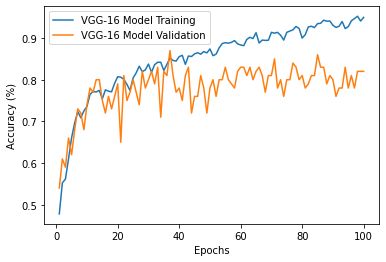

In [9]:
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

# create data
x=[]
for i in range(1,101):
    x.append(i)

# plot lines
plt.xlabel("Epochs")
plt.ylabel("Accuracy (%)")
plt.plot(x, vgghist.history['accuracy'], label = "VGG-16 Model Training", linestyle="-")
plt.plot(x, vgghist.history['val_accuracy'], label = "VGG-16 Model Validation", linestyle="-")
plt.legend()
plt.show()

In [10]:
vgg_model.evaluate(test_data)

3/3 [==============================] - 8s 3s/step - loss: 0.4656 - accuracy: 0.8533


[0.46555355191230774, 0.8533333539962769]

In [11]:
def create_inception_model():
    from tensorflow.keras.applications.inception_v3 import InceptionV3
    base_model = InceptionV3(input_shape = (photo_size, photo_size, 3), include_top = False, weights = 'imagenet')
    for layer in base_model.layers:
        layer.trainable = False
    # for layer_idx in range(len(pretrained_model.layers)):
    #     if layer_idx not in [1,2,3,305,306,307,308,309,310]:
    #         pretrained_model.layers[layer_idx].trainable = False
    from tensorflow.keras.optimizers import RMSprop
    from tensorflow.keras import layers
    x = layers.Flatten()(base_model.output)
    x = layers.Dense(512, activation='relu')(x)
    x = layers.Dropout(0.2)(x)

    # Add a final sigmoid layer with 1 node for classification output
    x = layers.Dense(95, activation='softmax')(x)
    model = tf.keras.models.Model(base_model.input, x)
    model.compile(optimizer = RMSprop(learning_rate=0.0001), loss = 'sparse_categorical_crossentropy', metrics = ['accuracy'])
    return model

In [12]:
inception_model=create_inception_model()
inception_model.summary()

87924736/87910968 [==============================] - 4s 0us/step
Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 111, 111, 32) 864         input_2[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 111, 111, 32) 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 111, 111, 32) 0           batch_normalization[0][0]        
___________________________

In [13]:
incephist = inception_model.fit(
    train_data,
    epochs=100,
    validation_data=validation_data
)
inception_model.save("inception_model.h5")

Epoch 1/100
20/20 [==============================] - 41s 2s/step - loss: 7.0839 - accuracy: 0.4961 - val_loss: 3.1352 - val_accuracy: 0.5600
Epoch 2/100
20/20 [==============================] - 34s 2s/step - loss: 3.6192 - accuracy: 0.5733 - val_loss: 2.6479 - val_accuracy: 0.6100
Epoch 3/100
20/20 [==============================] - 34s 2s/step - loss: 3.1710 - accuracy: 0.6029 - val_loss: 2.9852 - val_accuracy: 0.6300
Epoch 4/100
20/20 [==============================] - 33s 2s/step - loss: 2.7140 - accuracy: 0.6254 - val_loss: 1.3522 - val_accuracy: 0.7600
Epoch 5/100
20/20 [==============================] - 33s 2s/step - loss: 2.7229 - accuracy: 0.6183 - val_loss: 1.8416 - val_accuracy: 0.7400
Epoch 6/100
20/20 [==============================] - 33s 2s/step - loss: 2.0482 - accuracy: 0.6664 - val_loss: 1.6138 - val_accuracy: 0.7100
Epoch 7/100
20/20 [==============================] - 34s 2s/step - loss: 2.1305 - accuracy: 0.6242 - val_loss: 1.1294 - val_accuracy: 0.7300
Epoch 8/100
2

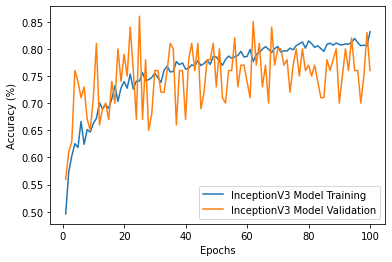

In [14]:
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

# create data
x=[]
for i in range(1,101):
    x.append(i)

# plot lines
plt.xlabel("Epochs")
plt.ylabel("Accuracy (%)")
plt.plot(x, incephist.history['accuracy'], label = "InceptionV3 Model Training", linestyle="-")
plt.plot(x, incephist.history['val_accuracy'], label = "InceptionV3 Model Validation", linestyle="-")
plt.legend()
plt.show()

In [15]:
inception_model.evaluate(test_data)

3/3 [==============================] - 4s 1s/step - loss: 0.4437 - accuracy: 0.8267


[0.4436624050140381, 0.8266666531562805]

In [16]:
!pip install efficientnet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 212.3 kB/s eta 0:00:00


In [17]:
def use_efficient_net(model_type='B0'):
    from tensorflow.keras.optimizers import RMSprop
    from keras.models import Model
    import efficientnet.tfkeras as efn
    if model_type=='B0':
        efn_model = efn.EfficientNetB0(input_shape = (photo_size, photo_size, 3), include_top = False, weights = 'imagenet')
    else:
        efn_model = efn.EfficientNetB7(input_shape = (photo_size, photo_size, 3), include_top = False, weights = 'imagenet')
    for layer in efn_model.layers:
        layer.trainable = False
    #
    x = efn_model.output
    x = Flatten()(x)
    x = Dense(256, activation="relu")(x)
    x = Dense(256, activation="relu")(x)
    x = Dropout(0.5)(x)
    # Add a final sigmoid layer with 1 node for classification output
    predictions = Dense(1, activation="sigmoid")(x)
    efficient_net = Model(efn_model.input,predictions)

    efficient_net.compile(RMSprop(learning_rate=0.0001, decay=1e-6),loss='binary_crossentropy',metrics=['accuracy'])
    return efficient_net
efficient_net=use_efficient_net('B0')
efficient_net.summary()

16818176/16804768 [==============================] - 5s 0us/step
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
stem_conv (Conv2D)              (None, 112, 112, 32) 864         input_3[0][0]                    
__________________________________________________________________________________________________
stem_bn (BatchNormalization)    (None, 112, 112, 32) 128         stem_conv[0][0]                  
__________________________________________________________________________________________________
stem_activation (Activation)    (None, 112, 112, 32) 0           stem_bn[0][0]                    
___________________________

In [18]:
effb0_history = efficient_net.fit(train_data, validation_data = validation_data, epochs = 100)
efficient_net.save("efficient_net_B0_model.h5")

Epoch 1/100
20/20 [==============================] - 42s 2s/step - loss: 0.8082 - accuracy: 0.6029 - val_loss: 0.5587 - val_accuracy: 0.7000
Epoch 2/100
20/20 [==============================] - 34s 2s/step - loss: 0.5888 - accuracy: 0.6928 - val_loss: 0.4984 - val_accuracy: 0.7300
Epoch 3/100
20/20 [==============================] - 34s 2s/step - loss: 0.5488 - accuracy: 0.7196 - val_loss: 0.5325 - val_accuracy: 0.7400
Epoch 4/100
20/20 [==============================] - 34s 2s/step - loss: 0.5549 - accuracy: 0.7153 - val_loss: 0.5408 - val_accuracy: 0.7000
Epoch 5/100
20/20 [==============================] - 34s 2s/step - loss: 0.5295 - accuracy: 0.7275 - val_loss: 0.4983 - val_accuracy: 0.7000
Epoch 6/100
20/20 [==============================] - 34s 2s/step - loss: 0.5228 - accuracy: 0.7295 - val_loss: 0.6222 - val_accuracy: 0.6600
Epoch 7/100
20/20 [==============================] - 34s 2s/step - loss: 0.5230 - accuracy: 0.7354 - val_loss: 0.4629 - val_accuracy: 0.7700
Epoch 8/100
2

/opt/conda/lib/python3.7/site-packages/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


In [19]:
efficient_net.evaluate(test_data)

3/3 [==============================] - 4s 1s/step - loss: 0.5099 - accuracy: 0.8000


[0.5099483728408813, 0.800000011920929]

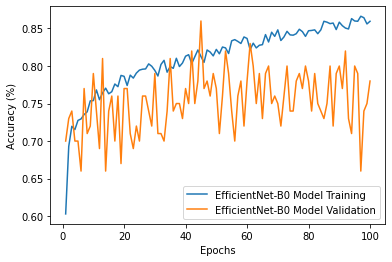

In [20]:
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

# create data
x=[]
for i in range(1,101):
    x.append(i)

# plot lines
plt.xlabel("Epochs")
plt.ylabel("Accuracy (%)")
plt.plot(x, effb0_history.history['accuracy'], label = "EfficientNet-B0 Model Training", linestyle="-")
plt.plot(x, effb0_history.history['val_accuracy'], label = "EfficientNet-B0 Model Validation", linestyle="-")
plt.legend()
plt.show()

In [21]:
def use_efficient_net(model_type='B0'):
    from tensorflow.keras.optimizers import RMSprop
    from keras.models import Model
    import efficientnet.tfkeras as efn
    if model_type=='B0':
        efn_model = efn.EfficientNetB0(input_shape = (photo_size, photo_size, 3), include_top = False, weights = 'imagenet')
    else:
        efn_model = efn.EfficientNetB7(input_shape = (photo_size, photo_size, 3), include_top = False, weights = 'imagenet')
    for layer in efn_model.layers:
        layer.trainable = False
    #
    x = efn_model.output
    x = Flatten()(x)
    x = Dense(256, activation="relu")(x)
    x = Dense(256, activation="relu")(x)
    x = Dropout(0.5)(x)
    # Add a final sigmoid layer with 1 node for classification output
    predictions = Dense(1, activation="sigmoid")(x)
    efficient_net = Model(efn_model.input,predictions)

    efficient_net.compile(RMSprop(learning_rate=0.0001, decay=1e-6),loss='binary_crossentropy',metrics=['accuracy'])
    return efficient_net
efficient_net=use_efficient_net('B7')
efficient_net.summary()

258449408/258434480 [==============================] - 45s 0us/step
Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
stem_conv (Conv2D)              (None, 112, 112, 64) 1728        input_4[0][0]                    
__________________________________________________________________________________________________
stem_bn (BatchNormalization)    (None, 112, 112, 64) 256         stem_conv[0][0]                  
__________________________________________________________________________________________________
stem_activation (Activation)    (None, 112, 112, 64) 0           stem_bn[0][0]                    
________________________

In [22]:
effb7_history = efficient_net.fit(train_data, validation_data = validation_data, epochs = 100)
efficient_net.save("efficient_net_B7_model.h5")

Epoch 1/100
20/20 [==============================] - 63s 2s/step - loss: 1.2288 - accuracy: 0.5694 - val_loss: 0.5410 - val_accuracy: 0.7300
Epoch 2/100
20/20 [==============================] - 40s 2s/step - loss: 0.6778 - accuracy: 0.6605 - val_loss: 0.5786 - val_accuracy: 0.6800
Epoch 3/100
20/20 [==============================] - 41s 2s/step - loss: 0.6296 - accuracy: 0.6877 - val_loss: 0.5532 - val_accuracy: 0.7000
Epoch 4/100
20/20 [==============================] - 41s 2s/step - loss: 0.6264 - accuracy: 0.6786 - val_loss: 0.5898 - val_accuracy: 0.7000
Epoch 5/100
20/20 [==============================] - 40s 2s/step - loss: 0.6071 - accuracy: 0.7003 - val_loss: 0.5381 - val_accuracy: 0.6600
Epoch 6/100
20/20 [==============================] - 40s 2s/step - loss: 0.5832 - accuracy: 0.7090 - val_loss: 0.5357 - val_accuracy: 0.7300
Epoch 7/100
20/20 [==============================] - 41s 2s/step - loss: 0.5941 - accuracy: 0.7003 - val_loss: 0.4361 - val_accuracy: 0.8000
Epoch 8/100
2

In [23]:
efficient_net.evaluate(test_data)

3/3 [==============================] - 5s 1s/step - loss: 0.4159 - accuracy: 0.8100


[0.41586166620254517, 0.8100000023841858]

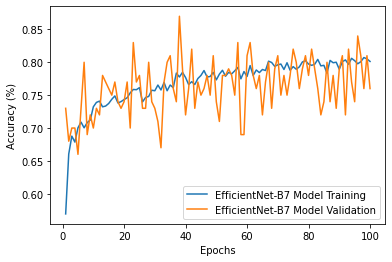

In [24]:
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

# create data
x=[]
for i in range(1,101):
    x.append(i)

# plot lines
plt.xlabel("Epochs")
plt.ylabel("Accuracy (%)")
plt.plot(x, effb7_history.history['accuracy'], label = "EfficientNet-B7 Model Training", linestyle="-")
plt.plot(x, effb7_history.history['val_accuracy'], label = "EfficientNet-B7 Model Validation", linestyle="-")
plt.legend()
plt.show()

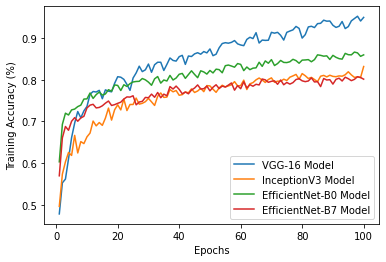

In [25]:
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

# create data
x=[]
for i in range(1,101):
    x.append(i)

# plot lines
plt.xlabel("Epochs")
plt.ylabel("Training Accuracy (%)")
plt.plot(x, vgghist.history['accuracy'], label = "VGG-16 Model", linestyle="-")
plt.plot(x, incephist.history['accuracy'], label = "InceptionV3 Model", linestyle="-")
plt.plot(x, effb0_history.history['accuracy'], label = "EfficientNet-B0 Model", linestyle="-")
plt.plot(x, effb7_history.history['accuracy'], label = "EfficientNet-B7 Model", linestyle="-")
plt.legend()
plt.show()

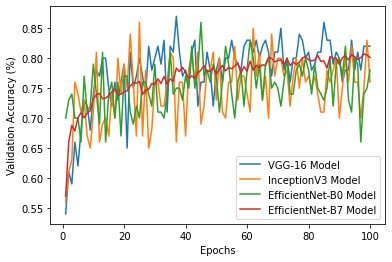

In [26]:
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

# create data
x=[]
for i in range(1,101):
    x.append(i)

# plot lines
plt.xlabel("Epochs")
plt.ylabel("Validation Accuracy (%)")
plt.plot(x, vgghist.history['val_accuracy'], label = "VGG-16 Model", linestyle="-")
plt.plot(x, incephist.history['val_accuracy'], label = "InceptionV3 Model", linestyle="-")
plt.plot(x, effb0_history.history['val_accuracy'], label = "EfficientNet-B0 Model", linestyle="-")
plt.plot(x, effb7_history.history['accuracy'], label = "EfficientNet-B7 Model", linestyle="-")
plt.legend()
plt.show()

In [27]:
from efficientnet.tfkeras import EfficientNetB0
from keras.models import load_model
efficientnet_b0_model= load_model('/kaggle/working/efficient_net_B0_model.h5')
efficientnet_b7_model= load_model('/kaggle/working/efficient_net_B7_model.h5')
vgg_model = load_model('/kaggle/working/vgg_model50.h5')
inception_v3_model = load_model('/kaggle/working/inception_model.h5')
#efficient_net_model.summary()

In [28]:
from PIL import Image
import numpy as np
from skimage import transform
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
photo_size=224
def load_image_from_path(filename):
    img = mpimg.imread(filename)
    imgplot = plt.imshow(img)
    plt.show()
    np_image = Image.open(filename)
    np_image = np.array(np_image).astype('float32') / 255
    np_image = transform.resize(np_image, (photo_size, photo_size, 3))
    np_image = np.expand_dims(np_image, axis=0)
    return np_image

029.jpg


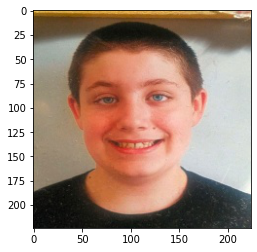

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
014.jpg


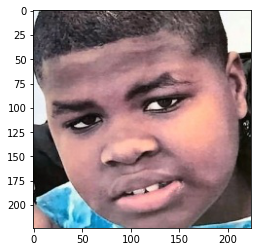

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
150.jpg


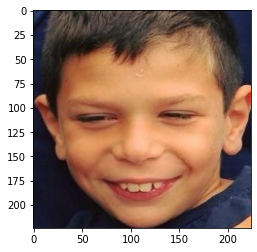

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
109.jpg


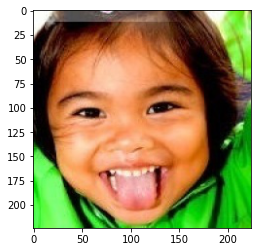

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
034.jpg


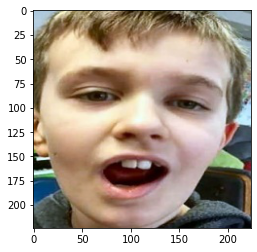

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
149.jpg


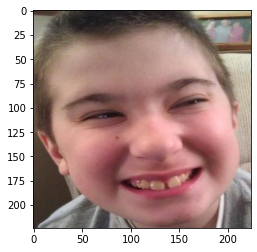

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
024.jpg


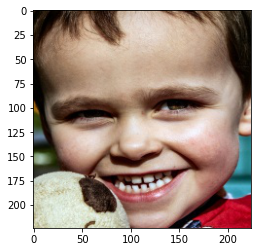

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
033.jpg


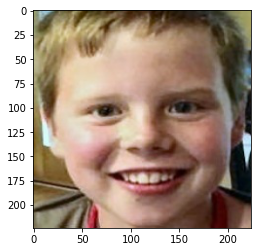

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
094.jpg


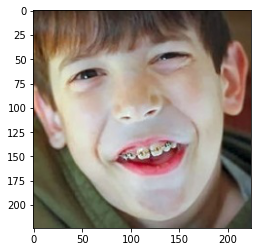

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
049.jpg


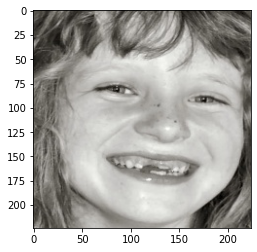

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
048.jpg


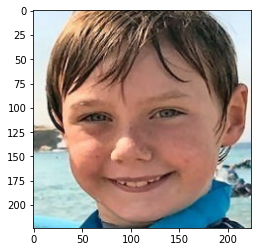

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
143.jpg


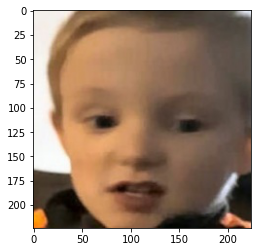

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
115.jpg


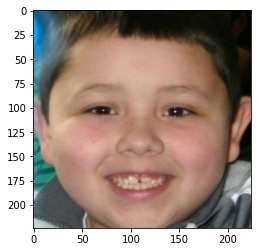

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
131.jpg


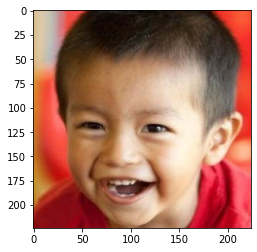

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
080.jpg


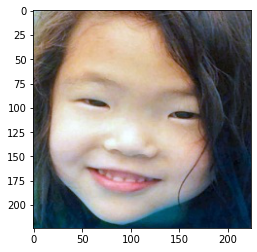

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
062.jpg


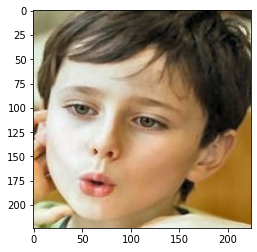

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
118.jpg


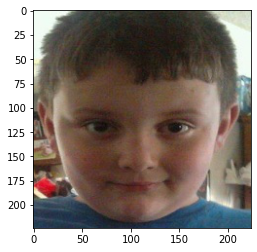

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
067.jpg


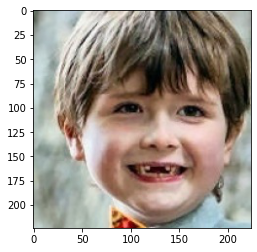

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
106.jpg


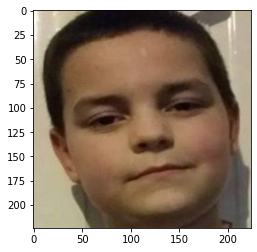

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
113.jpg


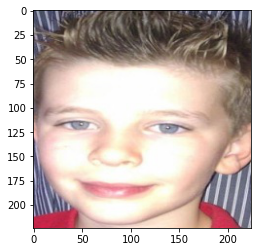

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
006.jpg


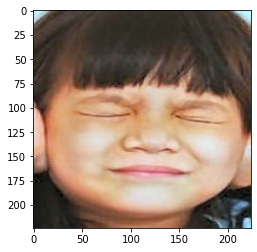

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
066.jpg


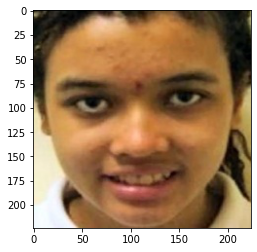

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
130.jpg


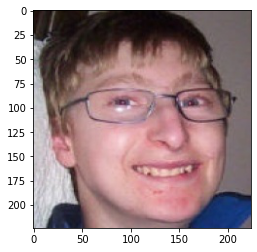

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
011.jpg


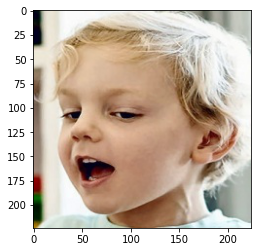

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
120.jpg


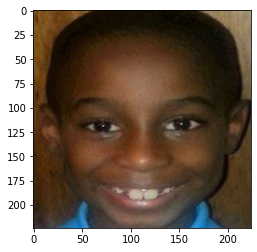

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
002.jpg


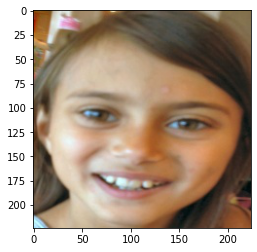

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
036.jpg


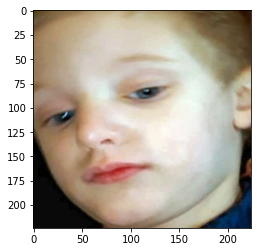

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
069.jpg


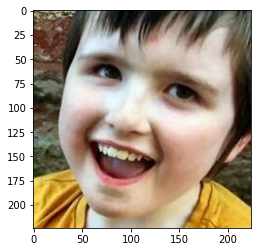

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
124.jpg


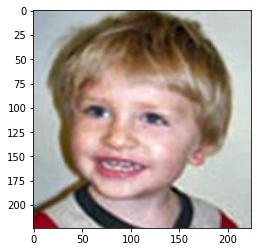

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
089.jpg


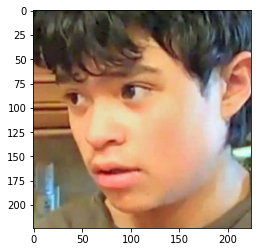

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
025.jpg


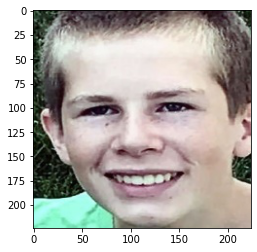

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
076.jpg


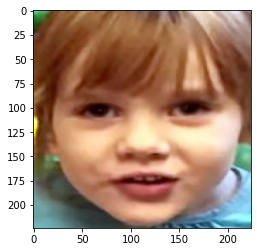

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
123.jpg


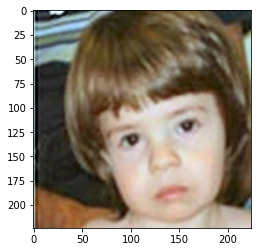

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
028.jpg


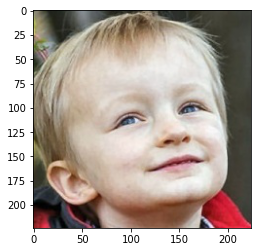

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
012.jpg


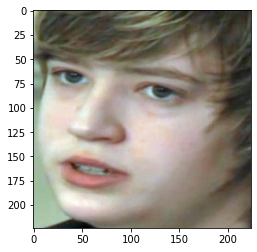

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
085.jpg


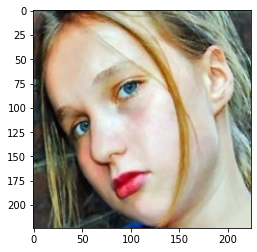

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
112.jpg


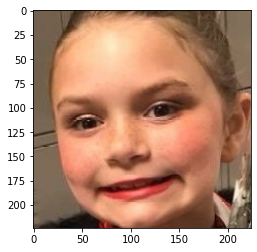

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
056.jpg


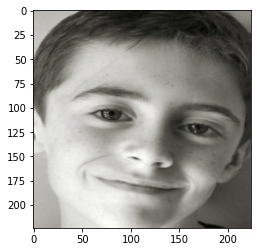

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
101.jpg


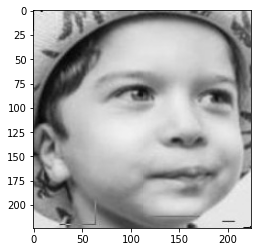

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
051.jpg


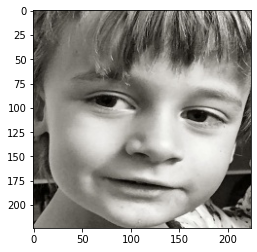

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
047.jpg


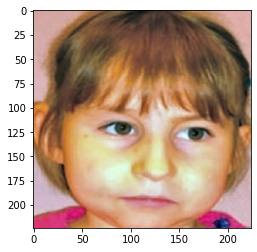

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
018.jpg


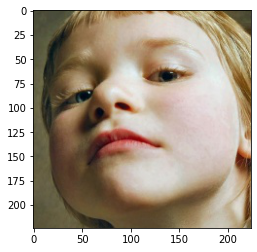

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
117.jpg


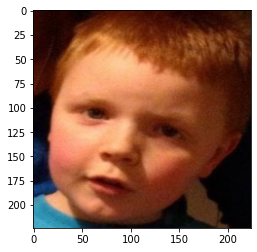

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
027.jpg


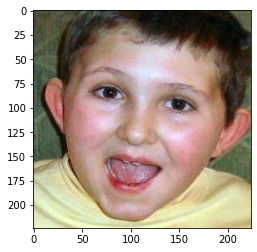

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
137.jpg


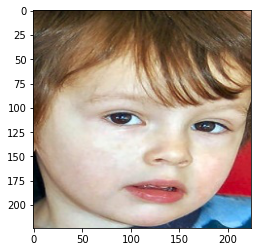

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
079.jpg


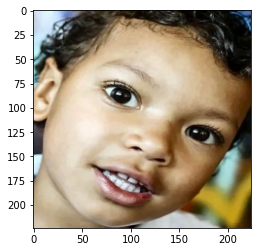

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
068.jpg


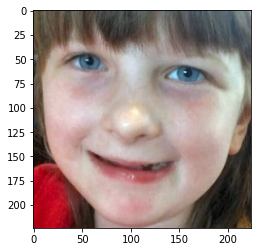

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
127.jpg


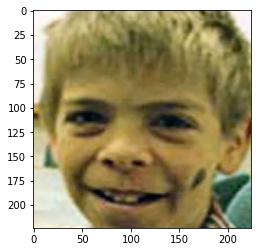

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
010.jpg


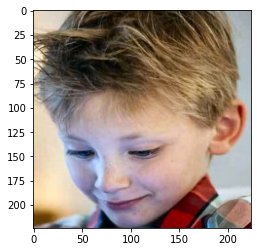

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
140.jpg


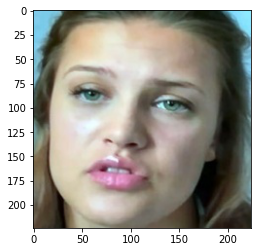

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
064.jpg


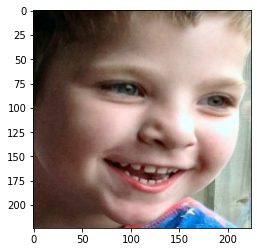

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
001.jpg


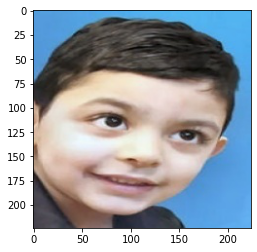

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
075.jpg


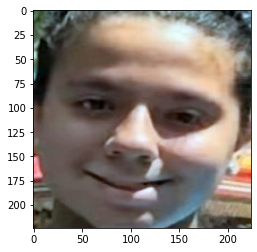

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
042.jpg


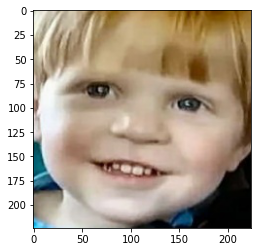

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
087.jpg


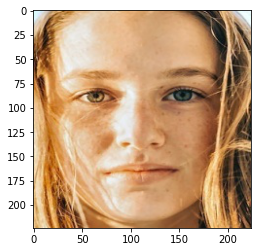

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
015.jpg


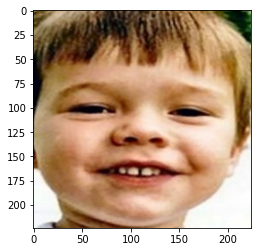

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
105.jpg


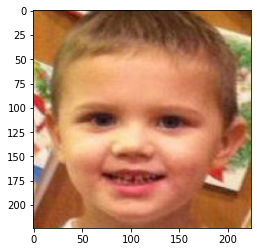

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
086.jpg


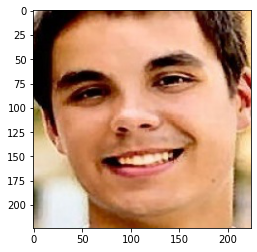

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
072.jpg


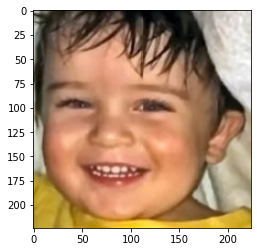

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
111.jpg


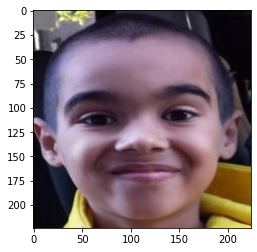

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
017.jpg


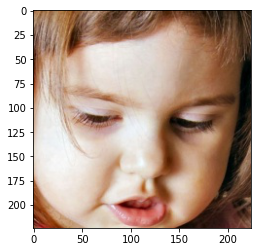

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
145.jpg


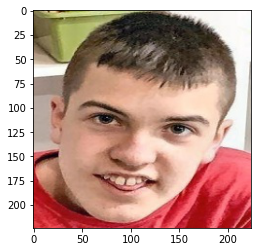

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
135.jpg


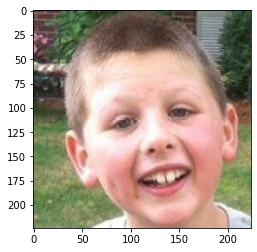

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
088.jpg


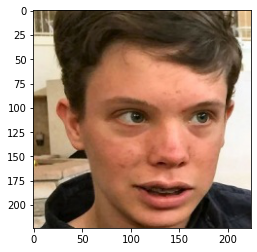

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
007.jpg


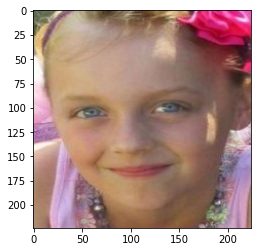

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
057.jpg


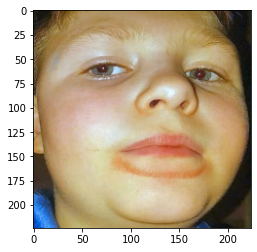

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
005.jpg


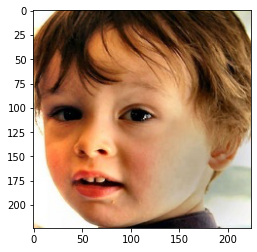

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
121.jpg


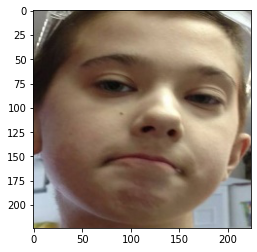

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
063.jpg


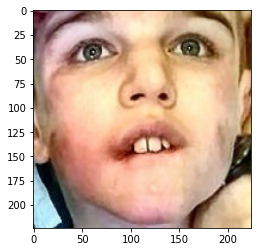

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
070.jpg


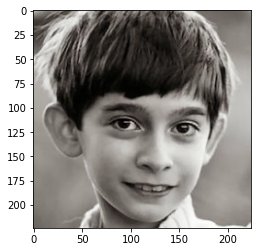

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
103.jpg


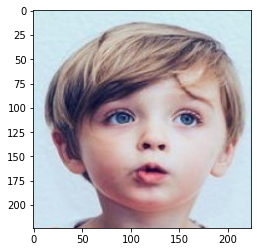

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
004.jpg


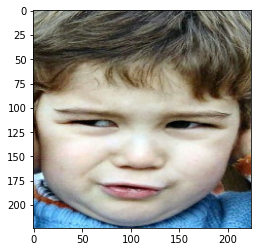

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
021.jpg


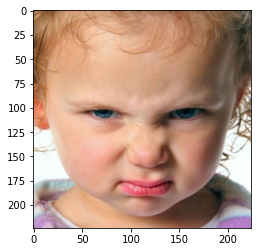

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
126.jpg


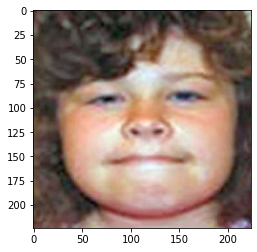

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
142.jpg


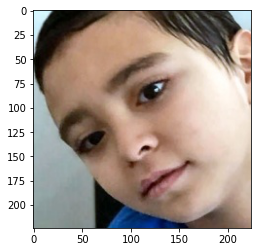

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
084.jpg


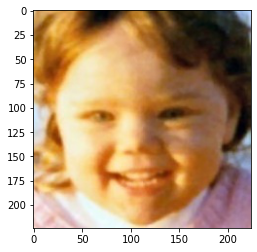

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
095.jpg


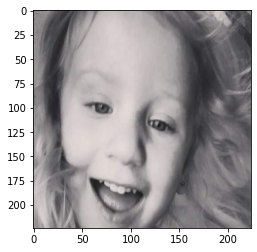

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
104.jpg


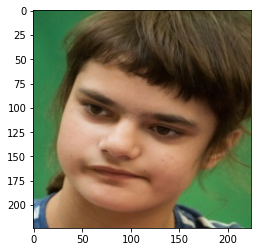

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
078.jpg


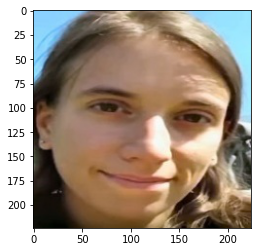

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
090.jpg


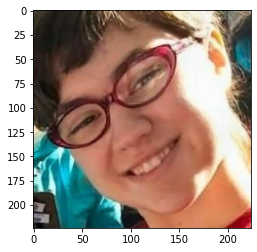

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
093.jpg


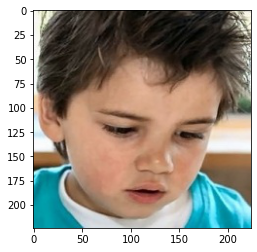

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
039.jpg


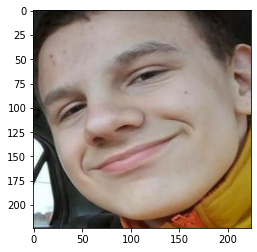

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
148.jpg


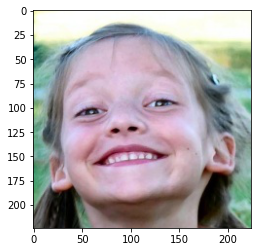

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
050.jpg


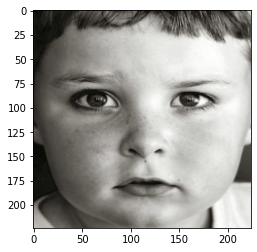

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
071.jpg


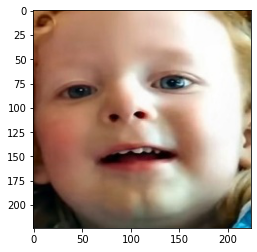

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
114.jpg


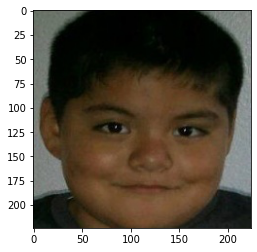

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
138.jpg


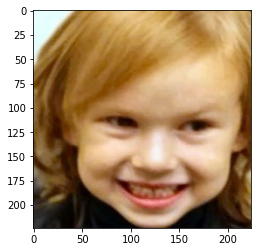

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
100.jpg


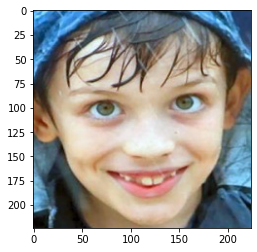

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
107.jpg


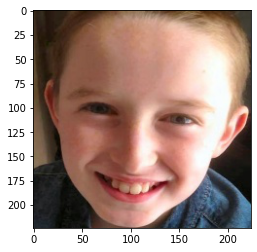

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
065.jpg


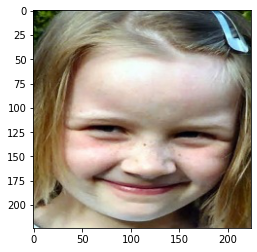

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
146.jpg


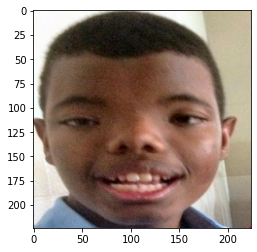

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
038.jpg


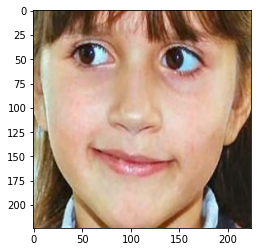

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
003.jpg


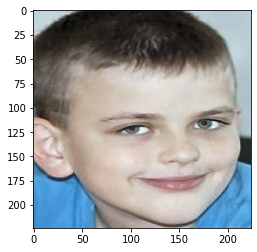

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
092.jpg


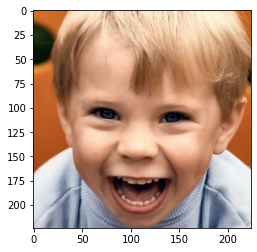

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
061.jpg


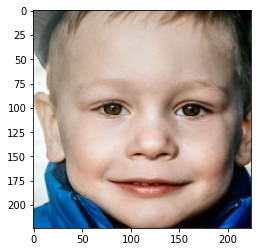

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
139.jpg


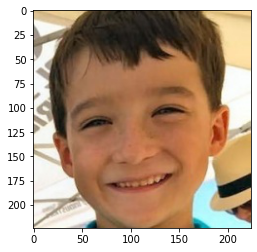

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
073.jpg


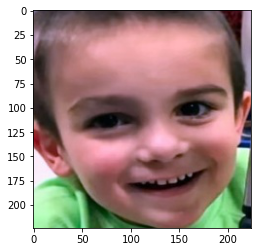

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
102.jpg


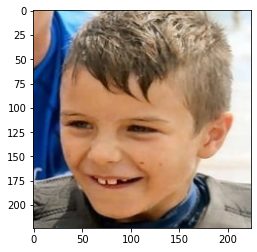

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
031.jpg


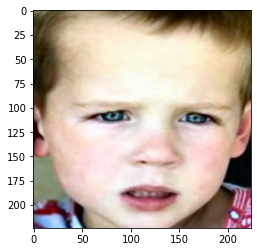

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
041.jpg


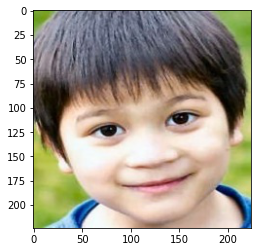

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
081.jpg


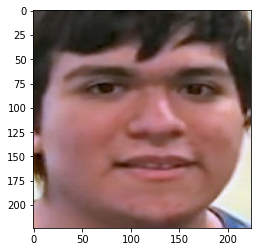

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
020.jpg


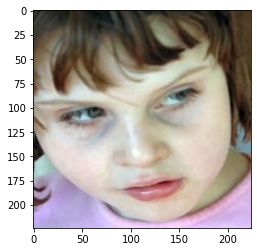

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
037.jpg


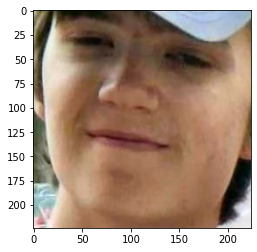

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
022.jpg


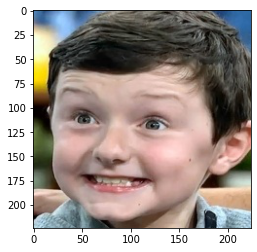

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
119.jpg


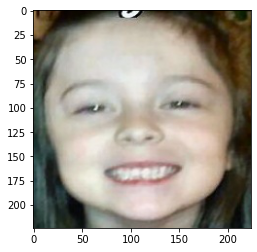

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
141.jpg


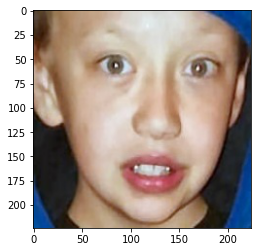

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
122.jpg


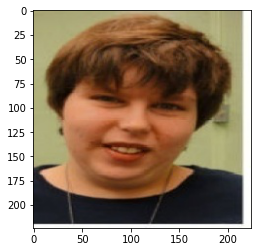

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
032.jpg


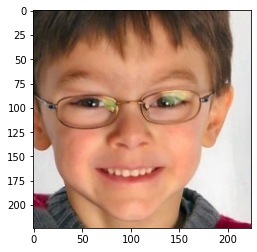

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
096.jpg


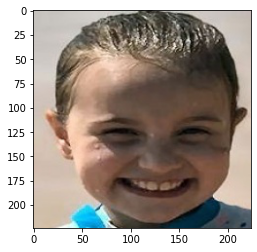

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
058.jpg


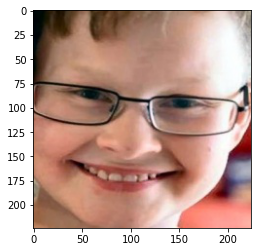

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
046.jpg


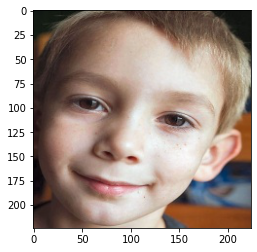

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
074.jpg


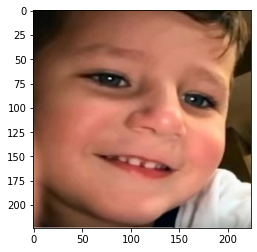

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
098.jpg


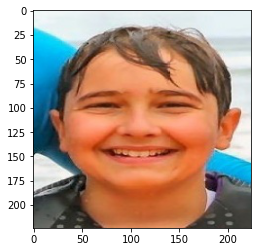

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
132.jpg


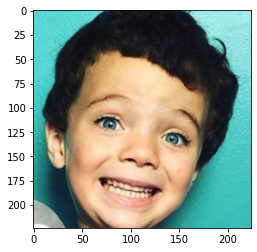

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
054.jpg


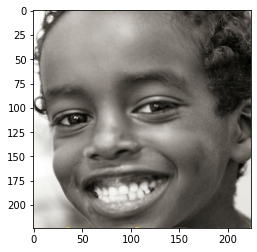

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
026.jpg


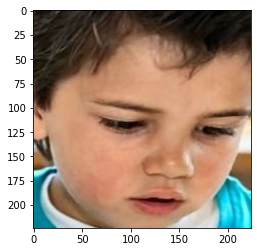

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
052.jpg


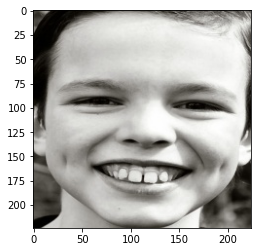

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
125.jpg


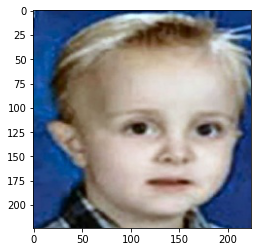

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
128.jpg


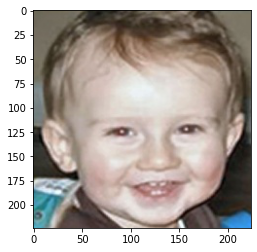

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
019.jpg


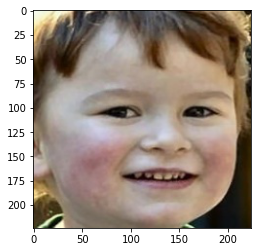

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
082.jpg


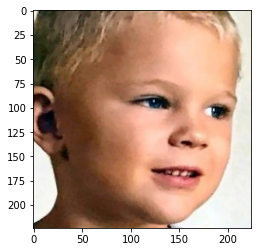

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
055.jpg


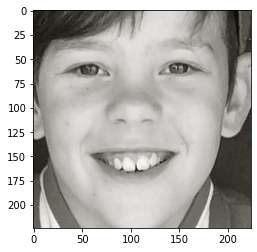

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
077.jpg


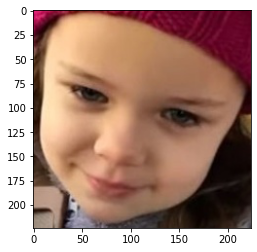

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
144.jpg


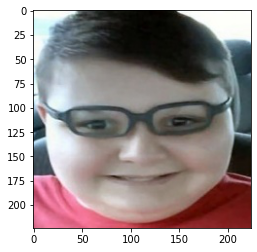

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
110.jpg


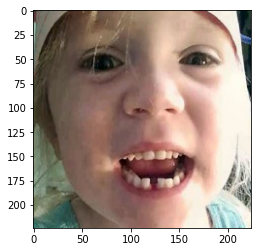

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
030.jpg


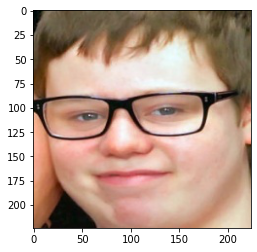

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
083.jpg


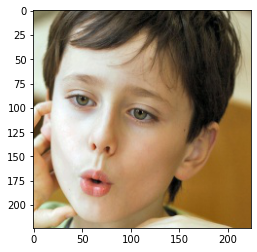

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
035.jpg


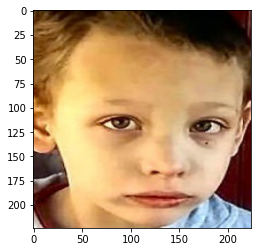

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
116.jpg


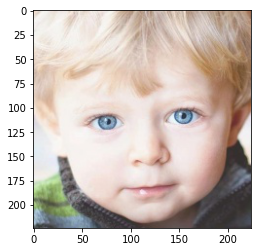

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
023.jpg


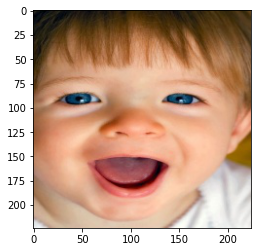

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
009.jpg


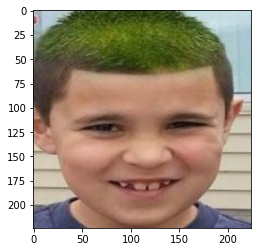

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
045.jpg


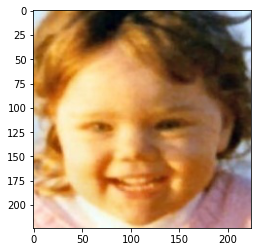

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
059.jpg


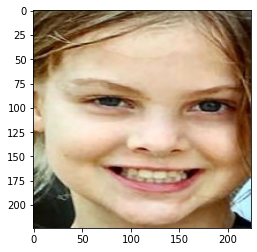

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
097.jpg


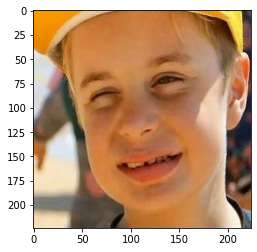

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
043.jpg


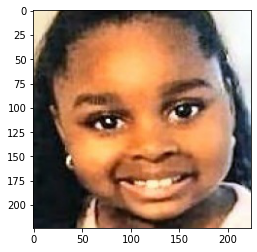

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
060.jpg


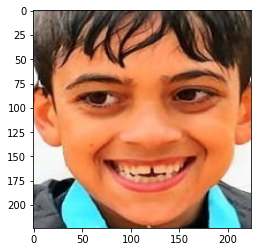

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
108.jpg


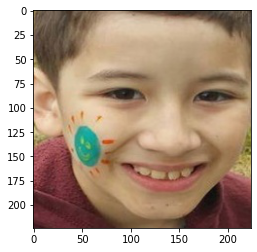

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
099.jpg


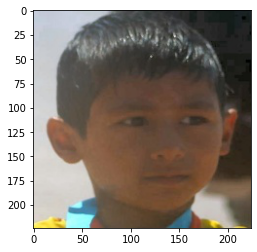

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
008.jpg


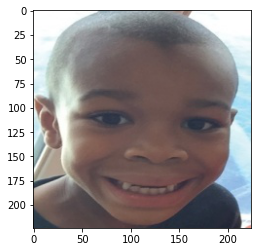

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
091.jpg


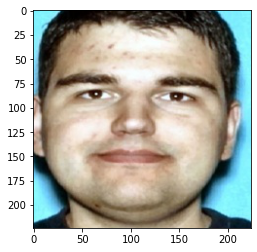

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
053.jpg


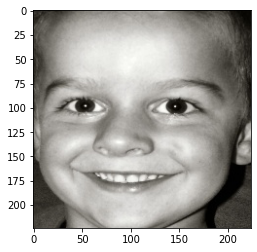

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
013.jpg


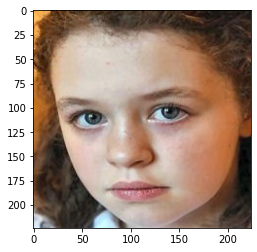

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
129.jpg


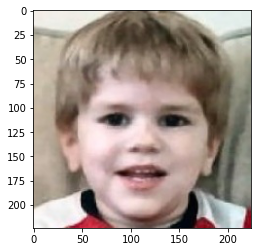

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
133.jpg


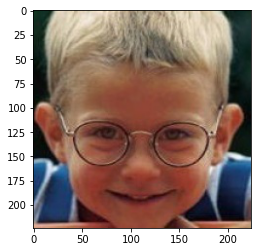

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
134.jpg


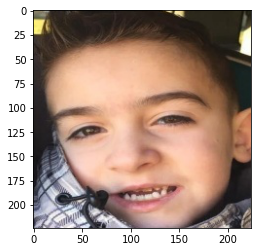

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
016.jpg


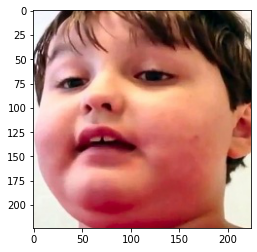

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
044.jpg


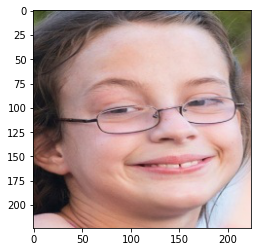

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
136.jpg


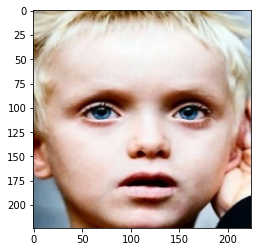

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
040.jpg


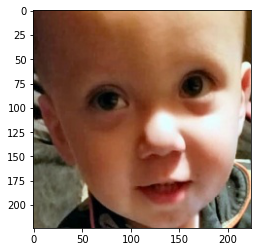

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic
147.jpg


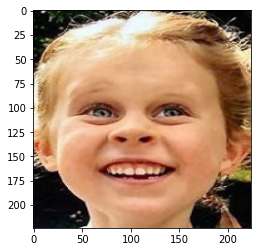

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Autistic
Efficient-NetB7	Autistic


In [29]:
import os
mTestPath = "/kaggle/input/autistic-children-facial-data-set/test/autistic"
for test in os.listdir(mTestPath):
    print(test)
    img = load_image_from_path(os.path.join(mTestPath, test))
    res = vgg_model.predict(img).argmax()
    if(res==1):
        print("VGG-16\t\tAutistic")
    else:
        print("VGG-16\t\tNon-Autistic")
    res = inception_v3_model.predict(img).argmax()
    if(res==1):
        print("Inception-V3\tAutistic")
    else:
        print("Inception-V3\tNon-Autistic")
    res = efficientnet_b0_model.predict(img).argmax()
    if(res==1):
        print("Efficient-NetB0\tNon-Autistic")
    else:
        print("Efficient-NetB0\tAutistic")
    res = efficientnet_b7_model.predict(img).argmax()
    if(res==1):
        print("Efficient-NetB7\tNon-Autistic")
    else:
        print("Efficient-NetB7\tAutistic")

029.jpg


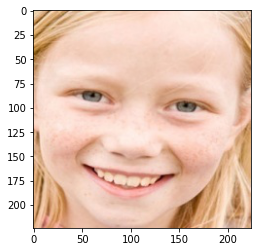

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
014.jpg


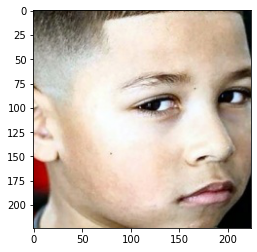

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
150.jpg


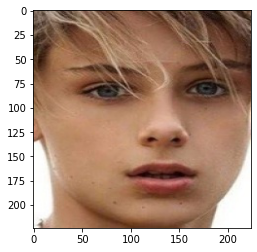

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
109.jpg


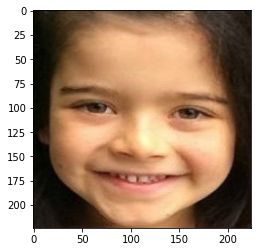

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
034.jpg


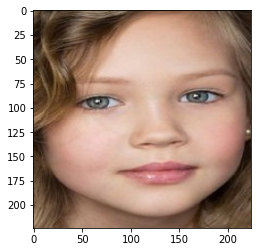

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
149.jpg


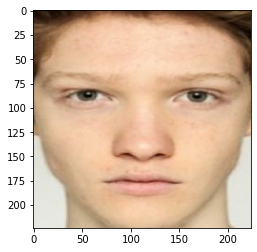

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
024.jpg


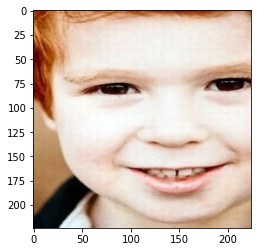

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
033.jpg


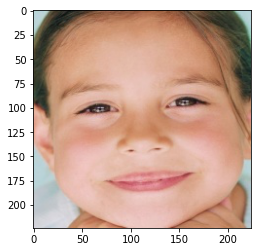

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
094.jpg


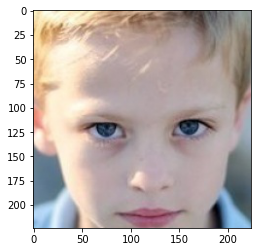

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
049.jpg


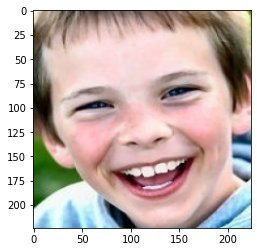

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
048.jpg


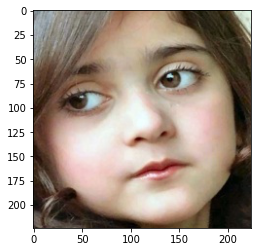

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
143.jpg


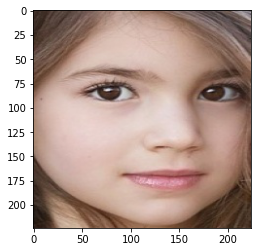

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
115.jpg


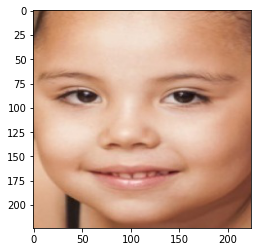

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
131.jpg


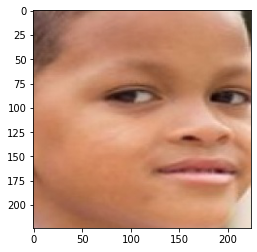

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
080.jpg


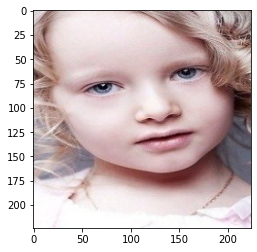

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
062.jpg


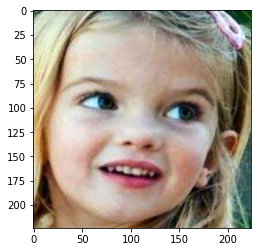

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
118.jpg


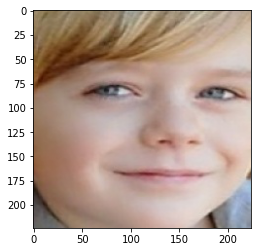

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
067.jpg


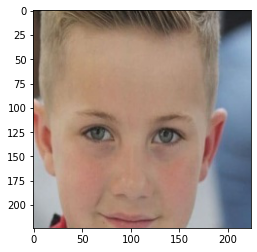

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
106.jpg


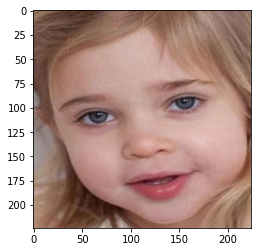

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
113.jpg


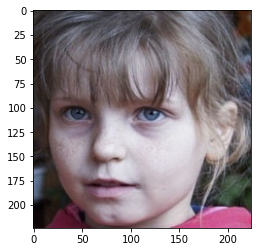

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
006.jpg


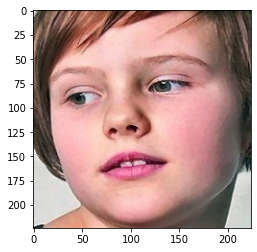

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
066.jpg


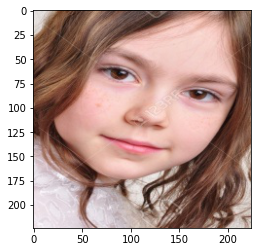

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
130.jpg


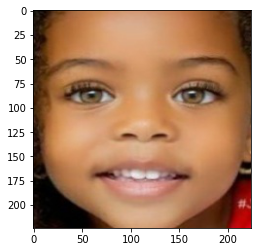

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
011.jpg


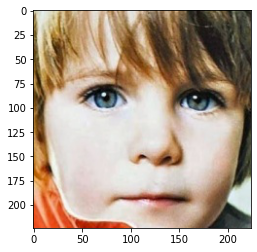

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
120.jpg


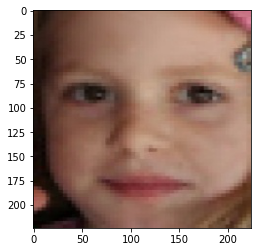

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
002.jpg


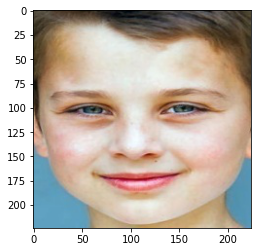

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
036.jpg


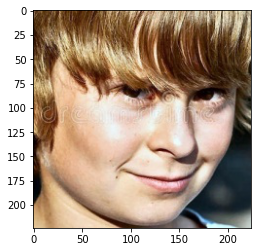

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
069.jpg


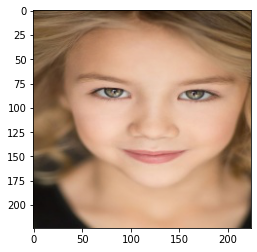

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
124.jpg


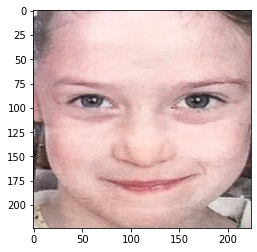

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
089.jpg


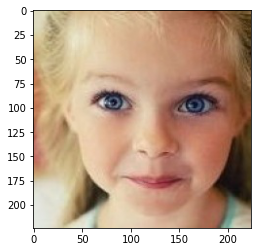

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
025.jpg


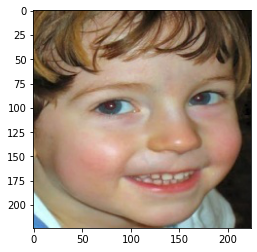

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
076.jpg


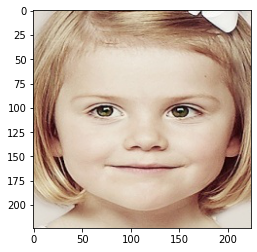

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
123.jpg


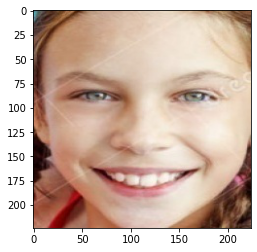

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
028.jpg


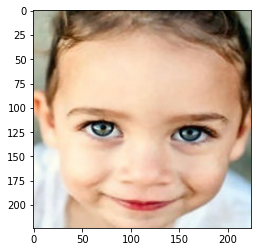

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
012.jpg


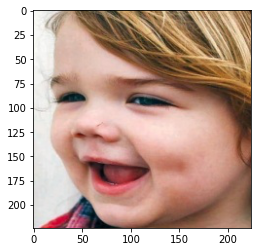

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
085.jpg


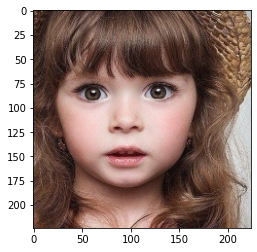

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
112.jpg


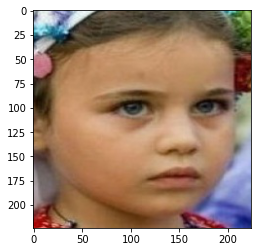

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
056.jpg


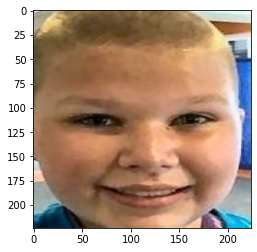

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
101.jpg


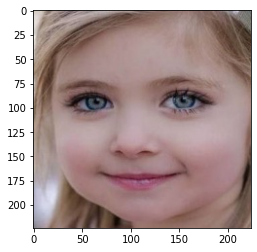

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
051.jpg


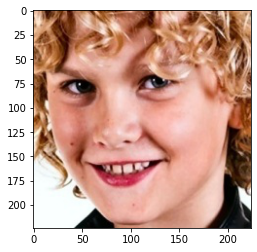

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
047.jpg


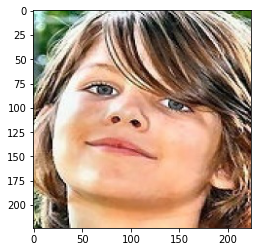

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
018.jpg


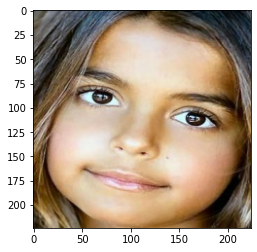

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
117.jpg


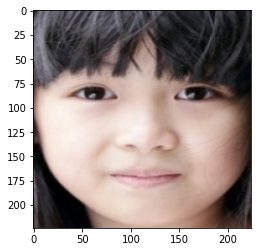

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
027.jpg


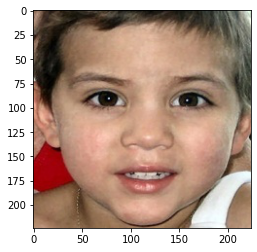

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
137.jpg


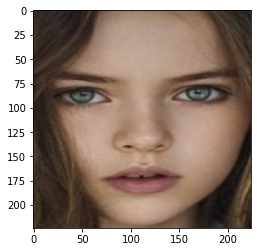

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
079.jpg


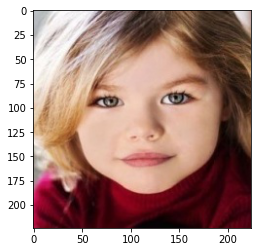

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
068.jpg


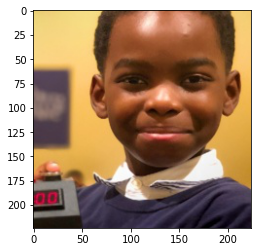

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
127.jpg


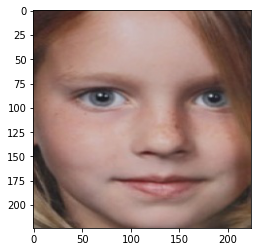

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
010.jpg


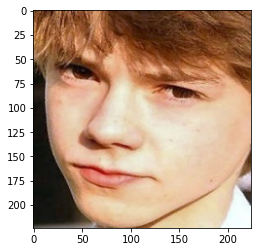

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
140.jpg


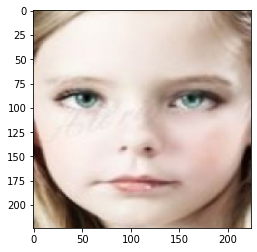

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
064.jpg


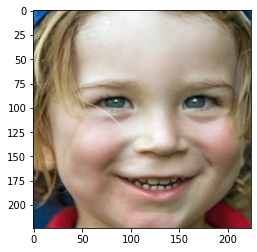

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
001.jpg


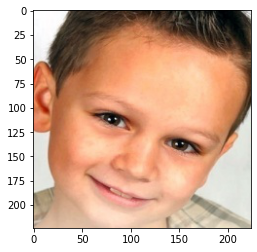

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
075.jpg


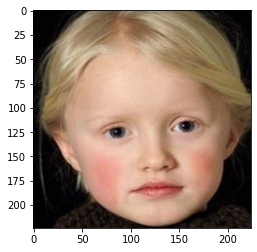

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
042.jpg


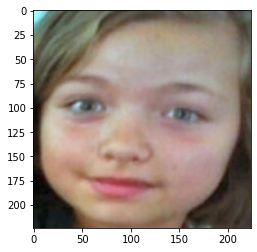

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
087.jpg


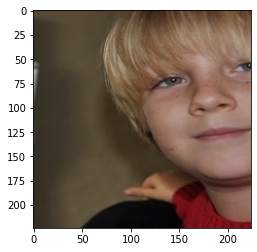

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
015.jpg


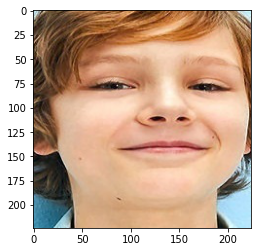

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
105.jpg


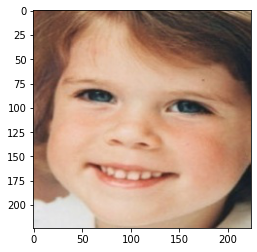

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
086.jpg


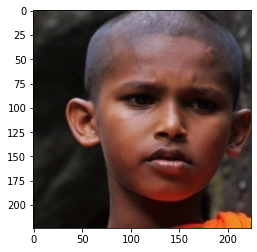

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
072.jpg


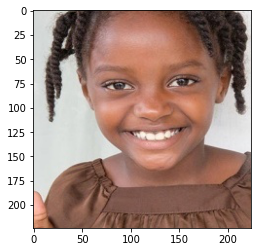

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
111.jpg


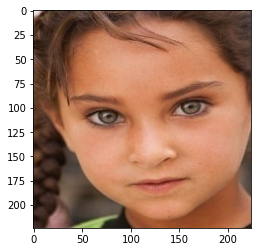

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
017.jpg


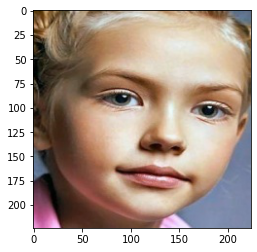

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
145.jpg


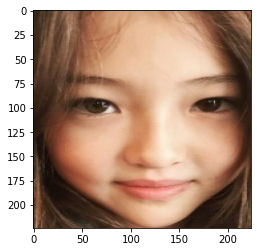

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
135.jpg


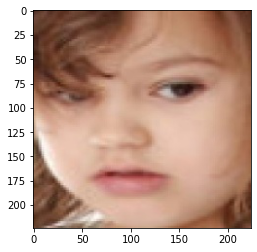

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
088.jpg


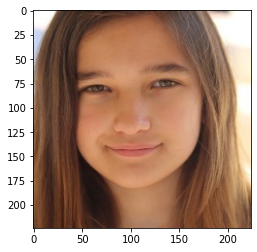

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
007.jpg


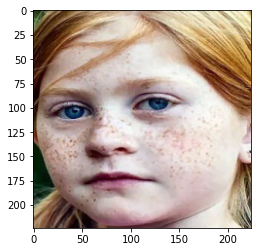

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
057.jpg


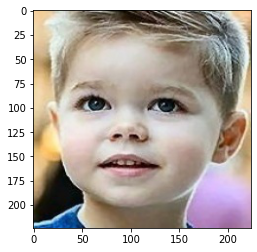

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
005.jpg


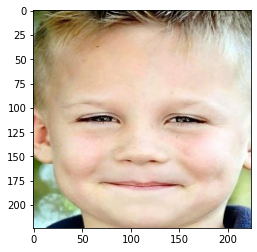

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
121.jpg


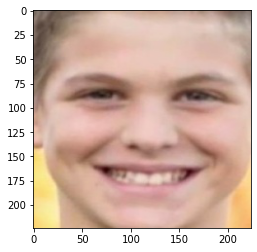

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
063.jpg


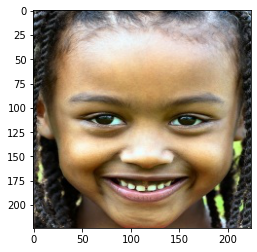

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
070.jpg


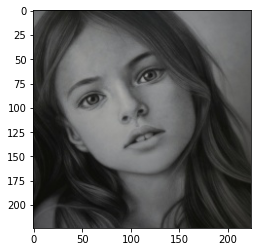

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
103.jpg


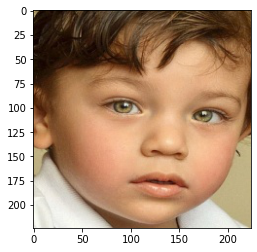

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
004.jpg


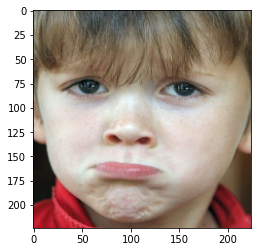

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
021.jpg


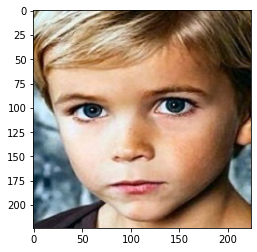

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
126.jpg


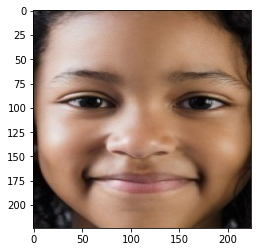

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
142.jpg


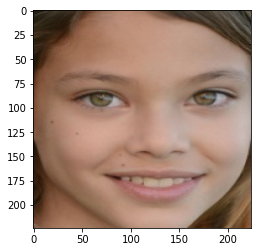

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
084.jpg


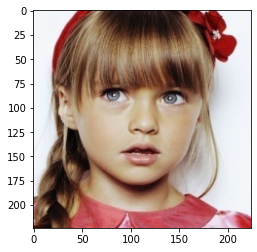

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
095.jpg


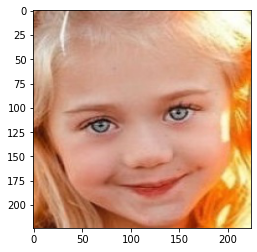

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
104.jpg


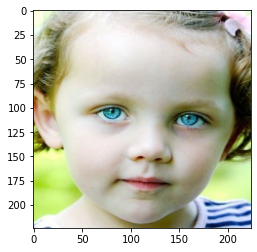

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
078.jpg


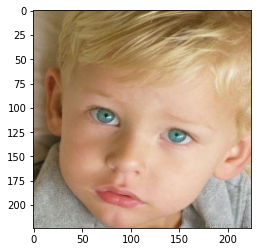

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
090.jpg


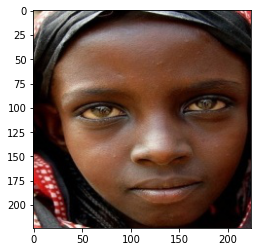

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
093.jpg


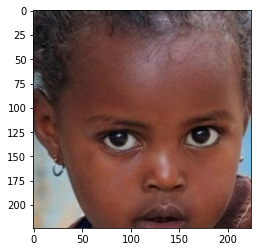

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
039.jpg


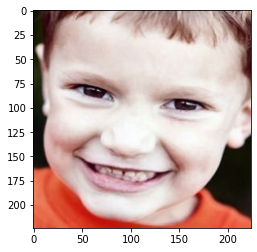

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
148.jpg


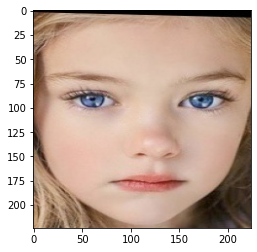

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
050.jpg


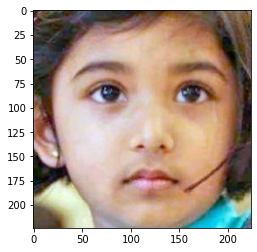

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
071.jpg


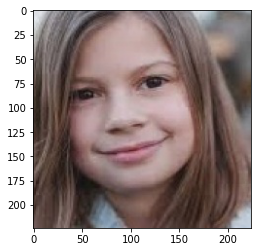

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
114.jpg


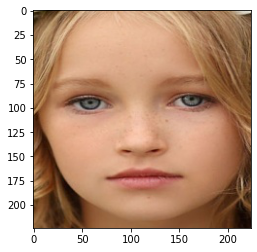

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
138.jpg


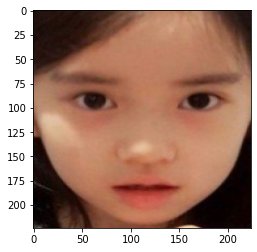

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
100.jpg


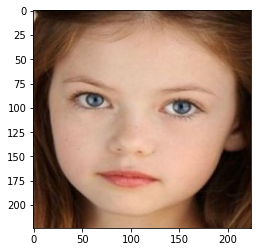

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
107.jpg


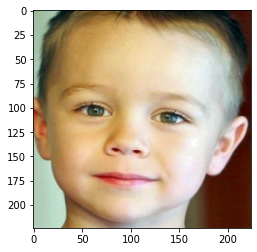

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
065.jpg


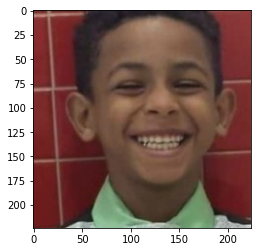

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
146.jpg


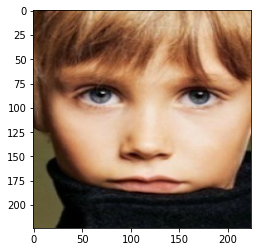

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
038.jpg


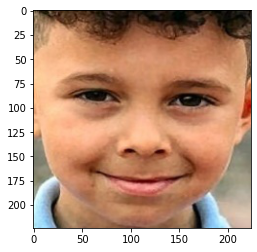

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
003.jpg


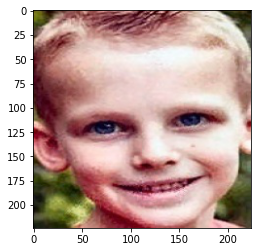

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
092.jpg


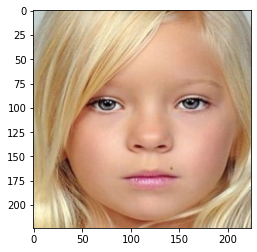

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
061.jpg


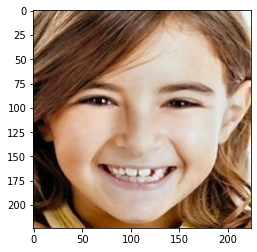

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
139.jpg


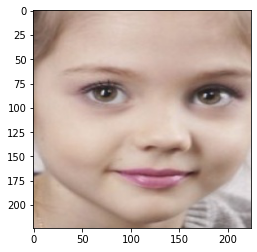

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
073.jpg


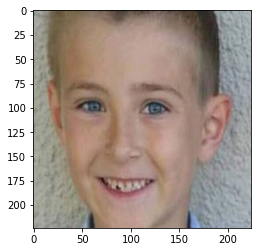

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
102.jpg


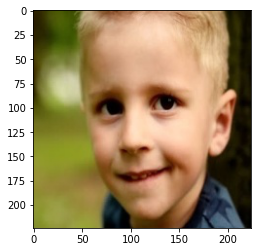

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
031.jpg


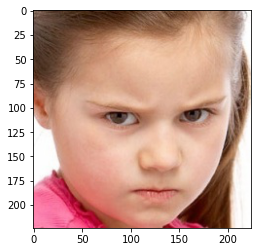

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
041.jpg


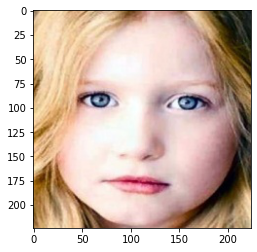

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
081.jpg


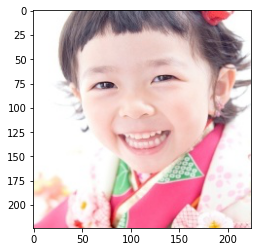

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
020.jpg


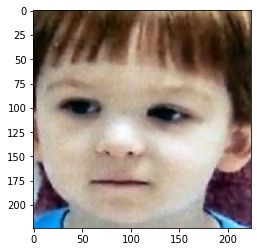

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
037.jpg


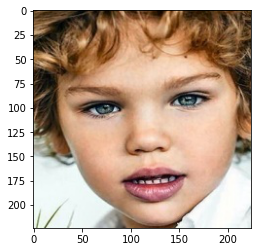

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
022.jpg


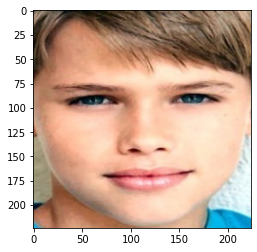

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
119.jpg


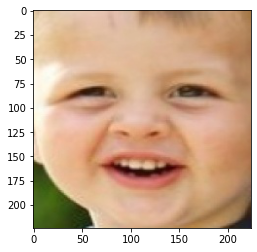

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
141.jpg


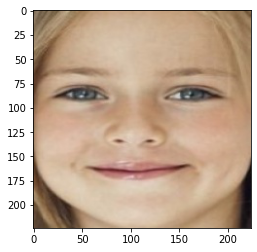

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
122.jpg


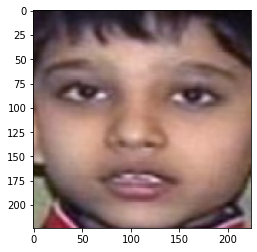

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
032.jpg


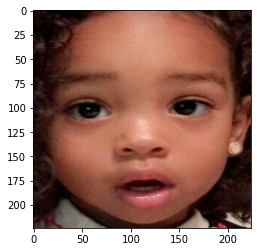

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
096.jpg


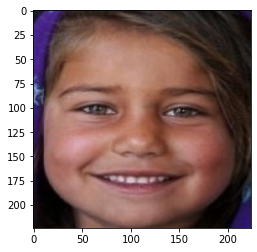

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
058.jpg


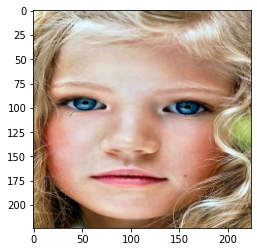

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
046.jpg


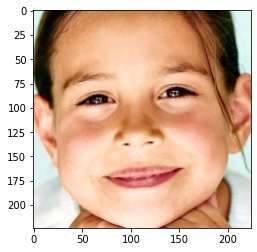

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
074.jpg


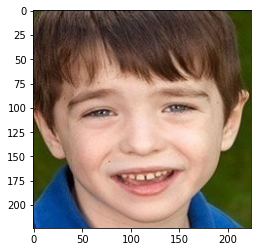

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
098.jpg


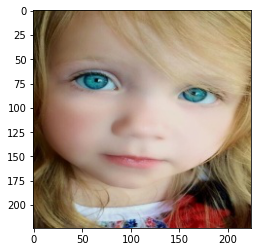

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
132.jpg


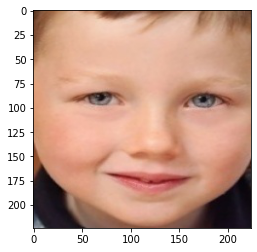

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
054.jpg


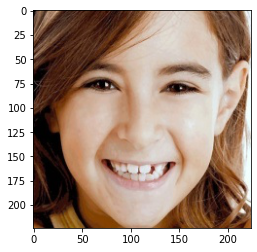

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
026.jpg


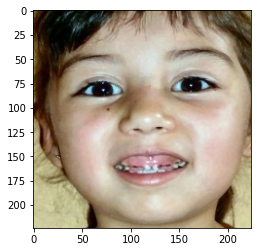

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
052.jpg


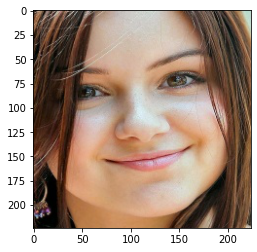

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
125.jpg


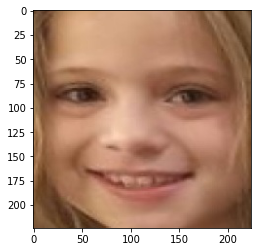

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
128.jpg


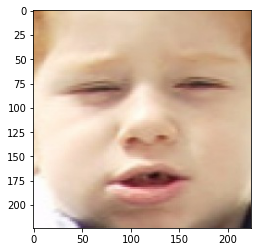

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
019.jpg


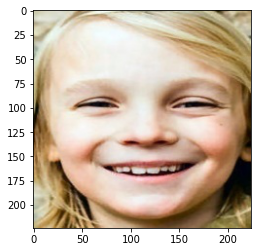

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
082.jpg


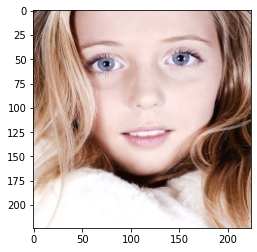

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
055.jpg


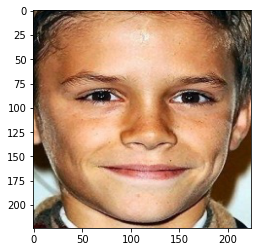

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
077.jpg


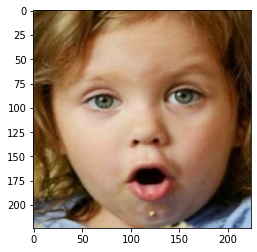

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
144.jpg


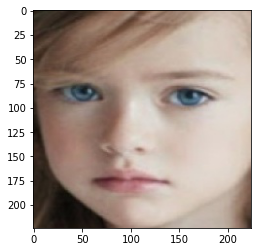

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
110.jpg


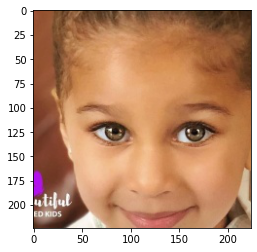

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
030.jpg


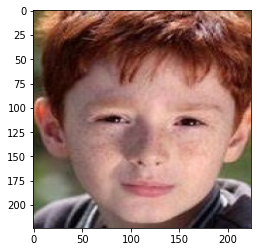

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
083.jpg


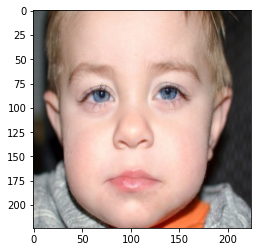

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
035.jpg


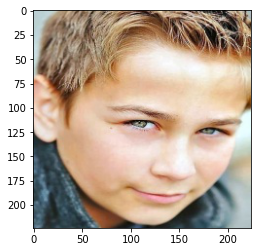

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
116.jpg


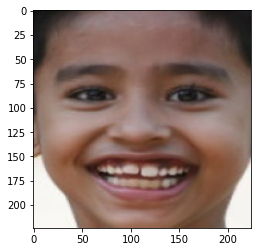

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
023.jpg


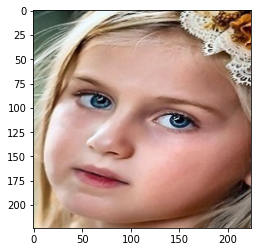

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
009.jpg


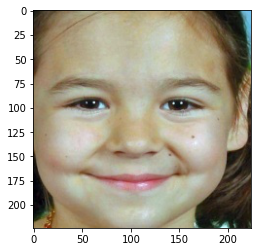

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
045.jpg


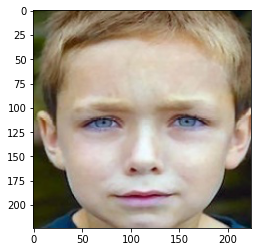

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
059.jpg


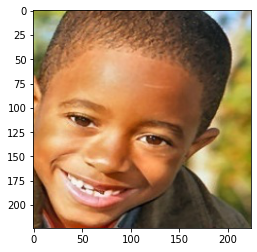

VGG-16		Non-Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
097.jpg


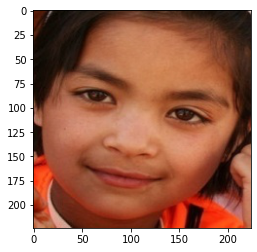

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
043.jpg


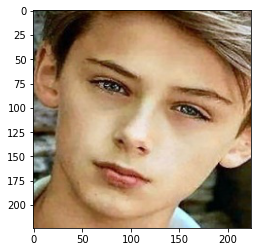

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
060.jpg


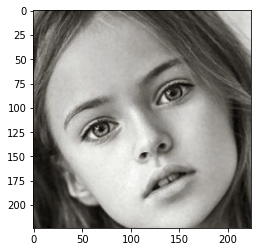

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
108.jpg


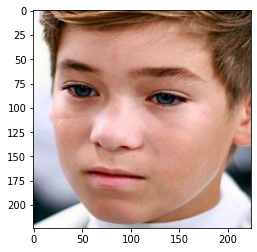

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
099.jpg


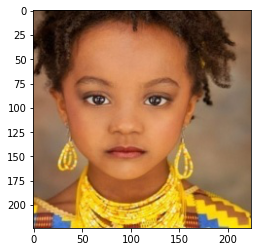

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
008.jpg


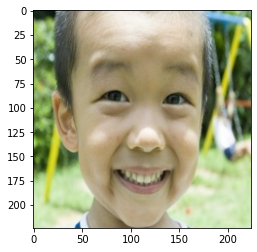

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
091.jpg


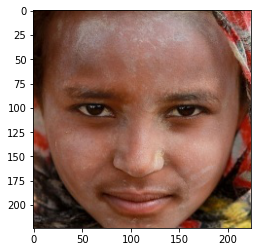

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
053.jpg


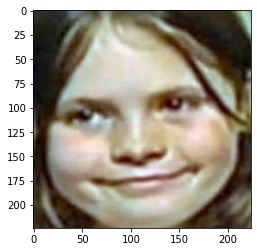

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
013.jpg


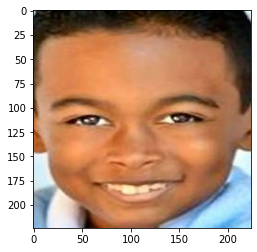

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
129.jpg


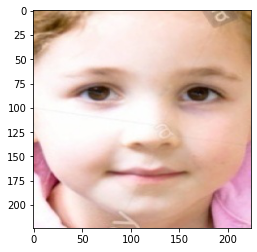

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
133.jpg


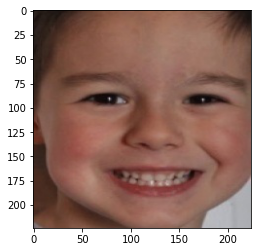

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
134.jpg


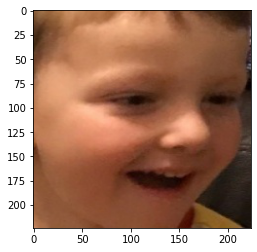

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
016.jpg


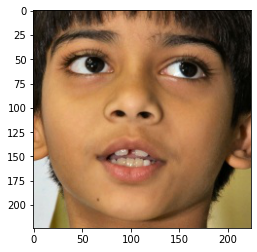

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
044.jpg


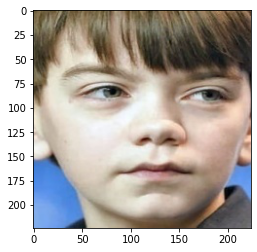

VGG-16		Autistic
Inception-V3	Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
136.jpg


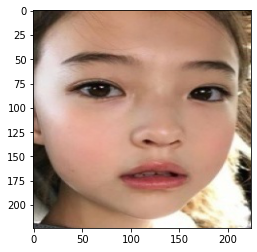

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
040.jpg


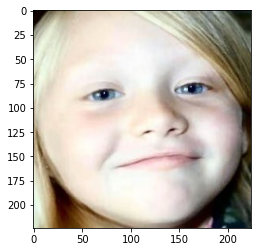

VGG-16		Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic
147.jpg


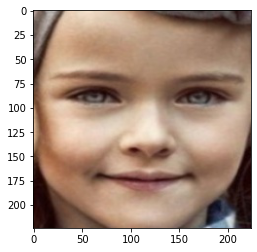

VGG-16		Non-Autistic
Inception-V3	Non-Autistic
Efficient-NetB0	Non-Autistic
Efficient-NetB7	Non-Autistic


In [30]:
import os
mTestPath = "/kaggle/input/autistic-children-facial-data-set/test/non_autistic"
for test in os.listdir(mTestPath):
    print(test)
    img = load_image_from_path(os.path.join(mTestPath, test))
    res = vgg_model.predict(img).argmax()
    if(res==1):
        print("VGG-16\t\tAutistic")
    else:
        print("VGG-16\t\tNon-Autistic")
    res = inception_v3_model.predict(img).argmax()
    if(res==1):
        print("Inception-V3\tAutistic")
    else:
        print("Inception-V3\tNon-Autistic")
    res = efficientnet_b0_model.predict(img).argmax()
    if(res==1):
        print("Efficient-NetB0\tAutistic")
    else:
        print("Efficient-NetB0\tNon-Autistic")
    res = efficientnet_b7_model.predict(img).argmax()
    if(res==1):
        print("Efficient-NetB7\tAutistic")
    else:
        print("Efficient-NetB7\tNon-Autistic")